À l’occasion de la Biennale d’Aix-en-Provence, dans le cadre de CHRONIQUES – Biennale des Imaginaires Numériques, l’association Arts Vivants présente au musée Granet, du 8 novembre 2024 au 19 janvier 2025, une exposition consacrée à l’artiste contemporain Étienne Rey et intitulée [La vibration des apparences](https://laurentperrinet.github.io/post/2024-11-07_vibration-apparences/).

Je décris ici le code utilisé pour générer une des oeuvres et qui a donné lieu à l'affiche.


<!-- TEASER_END -->

Importons d'abord les librairies nécessaires:

In [1]:
import cairo
from IPython.display import Image, display
from math import pi
from io import BytesIO

DOWNSCALE = 10
N_H, N_V = 12000//DOWNSCALE, 12000//DOWNSCALE

def disp(draw_func):
    surface = cairo.ImageSurface(cairo.FORMAT_ARGB32, N_H, N_V)
    ctx = cairo.Context(surface)
    draw_func(ctx, N_H=N_H, N_V=N_V)
    with BytesIO() as fileobj:
        surface.write_to_png(fileobj)
        display(Image(fileobj.getvalue(), width=N_H))

def render(draw_func, savepath):
    with cairo.PDFSurface(f"{savepath}.pdf", N_H, N_V) as surface:
        ctx = cairo.Context(surface)
        draw_func(ctx, N_H=N_H, N_V=N_V)        

def render_png(draw_func, savepath):
    with cairo.ImageSurface(cairo.FORMAT_ARGB32, N_H, N_V) as surface:
        surface = cairo.ImageSurface(cairo.FORMAT_ARGB32, N_H, N_V)
        ctx = cairo.Context(surface)
        draw_func(ctx, N_H=N_H, N_V=N_V)
        surface.write_to_png(f"{savepath}")

figpath = 'figures'
%mkdir -p {figpath}
import numpy as np
np.set_printoptions(precision=2, suppress=True)

In [2]:
%load_ext watermark
%watermark -i -h -m -v -p numpy,matplotlib 

Python implementation: CPython
Python version       : 3.12.3
IPython version      : 8.27.0

numpy     : 1.26.4
matplotlib: 3.9.2

Compiler    : Clang 16.0.6 
OS          : Darwin
Release     : 24.1.0
Machine     : x86_64
Processor   : i386
CPU cores   : 36
Architecture: 64bit

Hostname: Ahsoka



# retinotopic grid

- grille hexagonale 
- projetée sur une carte log-polaire
- taille des points proportionnelle à la distance à l'origine
- couleur variant avec la distance à l'origine


In [3]:
def hue_to_rgba(hue, alpha=1.):
    """
    Convert a hue value to an RGB color.
    The hue value should be in degrees [0, 360).
    """
    hue = np.mod(hue, 360.)
    h = hue / 60.0
    x = 1 - abs(h % 2 - 1)
    if h < 1:
        r, g, b = 1, x, 0
    elif h < 2:
        r, g, b = x, 1, 0
    elif h < 3:
        r, g, b = 0, 1, x
    elif h < 4:
        r, g, b = 0, x, 1
    elif h < 5:
        r, g, b = x, 0, 1
    else:
        r, g, b = 1, 0, x
    
    return r, g, b, alpha


In [4]:
def circle(cr, x, y, radius):
    """
    x      - center x
    y      - center y
    width  - width of ellipse  (in x direction when angle=0)
    height - height of ellipse (in y direction when angle=0)
    angle  - angle in radians to rotate, clockwise
    """
    cr.save()
    cr.translate(x, y)
    cr.scale(radius / 2.0, radius / 2.0)
    cr.arc(0.0, 0.0, 1.0, 0.0, 2.0 * pi)
    cr.restore()


0, 1, 1, 2, 3, 5, 8, 13, 21, 34, 55, 89, 144, 233 	377 	610 	987 	1597 	2584 	4181 

In [5]:
N_rho, N_phi = 256, 256
N_rho, N_phi = 512, 512
N_rho, N_phi = 34, 233

def retino_grid(cr, N_rho, N_phi, N_H, N_V, offset, size_mag, ecc_max, alpha, c1, c2, power, operator, channel='both'):

    cr.scale(N_H, N_V)
    cr.set_operator(operator)

    # Compute the grid
    # https://laurentperrinet.github.io/sciblog/posts/2020-04-16-creating-an-hexagonal-grid.html
    # phi_v, rho_v = np.meshgrid(np.linspace(0, 2*np.pi, N_phi, endpoint=False), 
    #                            np.geomspace(logpolar_min, 1, N_rho, endpoint=True), sparse=False, indexing='xy')
    phi_v, rho_v = np.meshgrid(np.linspace(0, 2*np.pi, N_phi, endpoint=False), 
                               np.linspace(0, ecc_max, N_rho+1, endpoint=True)[1:], sparse=False, indexing='xy')
    
    phi_v[::2, :] += np.pi/N_phi


    if channel=='both':
        offsets = [-offset, offset]
        colors = [c1, c2]
    elif channel==1:
        offsets = [0]
        colors = [c1]
    elif channel==2:
        offsets = [0]
        colors = [c2]
    else:
        raise(ValueError, 'Watchyadoin?')

    for offset_, color in zip(offsets, colors):
        # convert to cartesian coordinates
        X =  rho_v * np.sin(phi_v) + offset_
        Y =  rho_v * np.cos(phi_v)
        X = (X+1)/2
        Y = (Y+1)/2
        R = size_mag * rho_v**power / N_rho

        # draw 
        for x, y, r in zip(X.ravel(), Y.ravel(), R.ravel()):
            circle(cr, x, y, r)
            cr.set_source_rgba(*hue_to_rgba(color, alpha))
            cr.fill()

    return cr


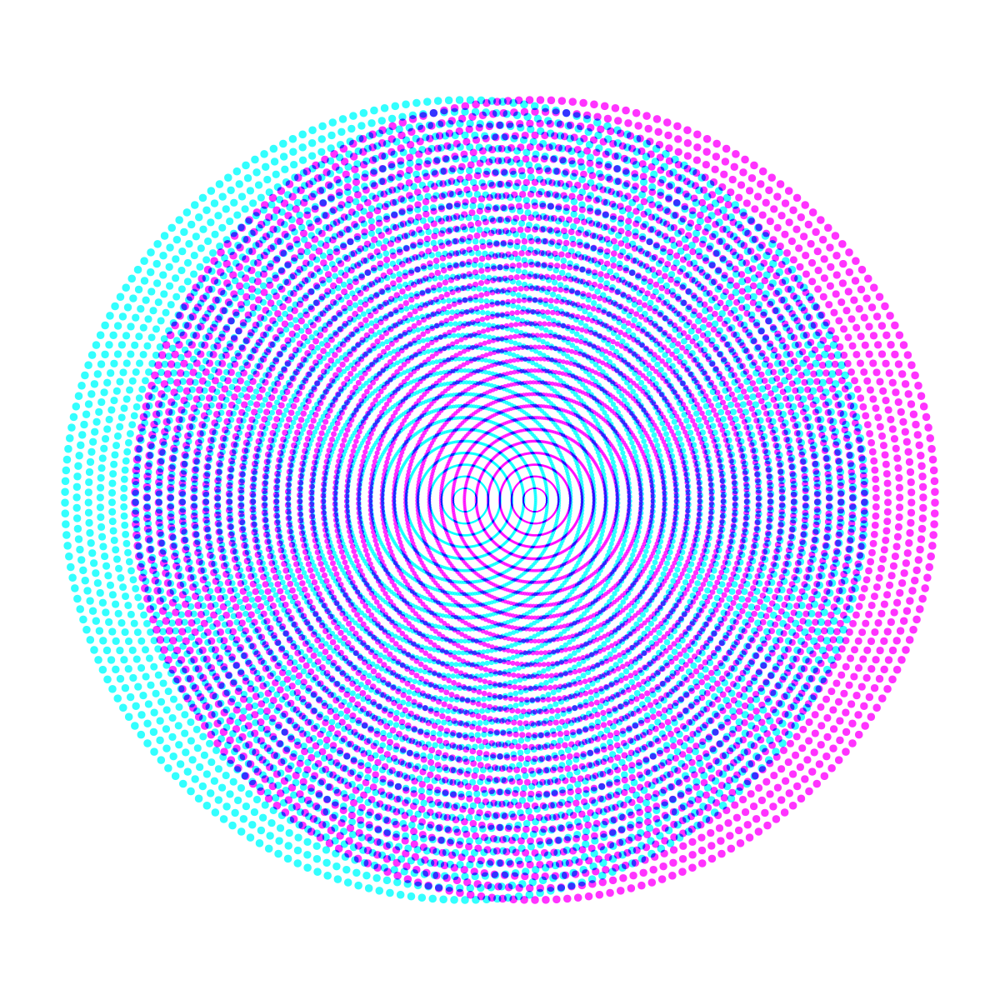

In [6]:
# blue 
c_blue = 240
dc = 60
opts = dict(N_rho=N_rho, N_phi=N_phi, N_H=N_H, N_V=N_V,
            offset=0.07, size_mag=0.3, ecc_max=0.8, alpha=0.80, c1=c_blue-dc, c2=c_blue+dc, power=.5, operator=cairo.OPERATOR_MULTIPLY)


@disp
def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts)

In [7]:
# for channel in [1, 2]:
#     def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, channel=channel, **opts)
#     render(draw, savepath + f'_{channel}')

In [8]:
# def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts)
# render(draw, savepath + '_both')

# rôle des différents paramètres

L'interférence entre les deux structures ci-dessus est réglée par plusieurs paramètres que nous allons maintenant explorer pour étudier leur rôle sur les émergences d'une perception différente.

In [9]:

N_scan = 9

## alpha

Étudions d'abord la transparence des deux différents trames.

alpha_=1.00e-01


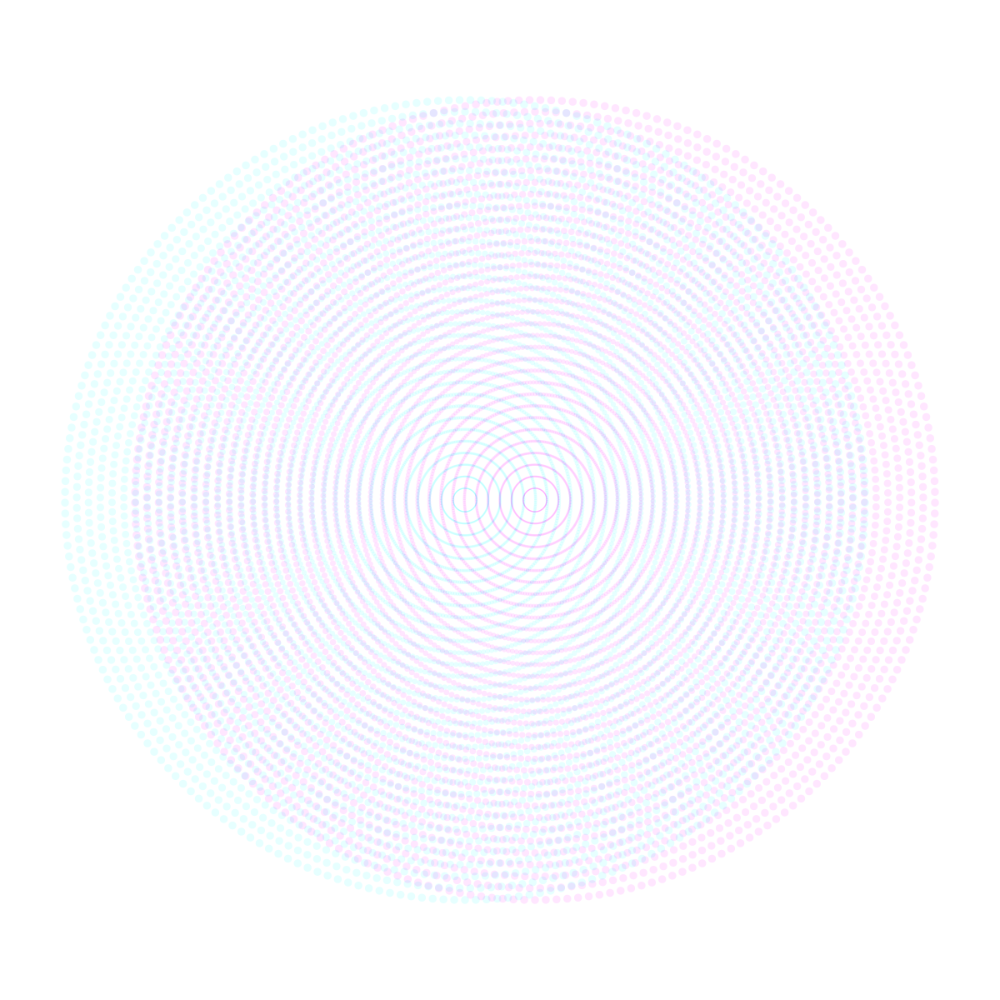

alpha_=2.13e-01


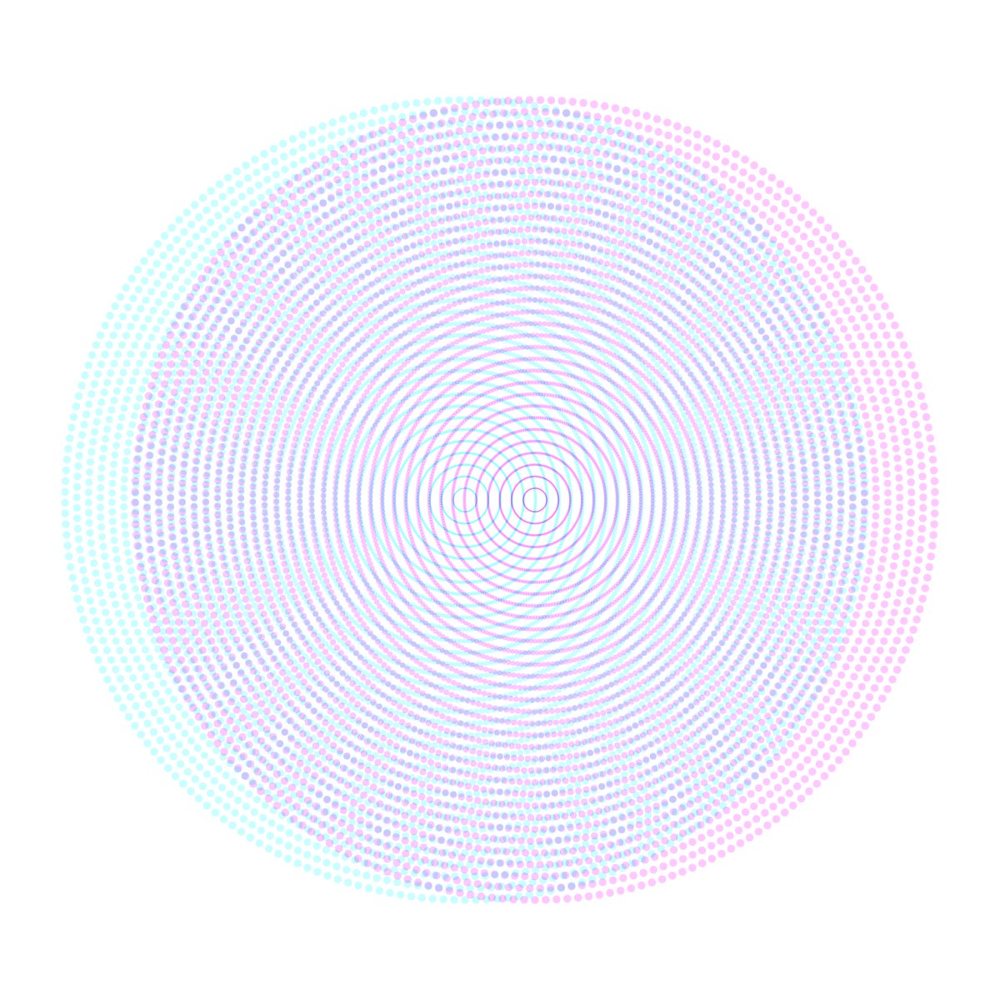

alpha_=3.25e-01


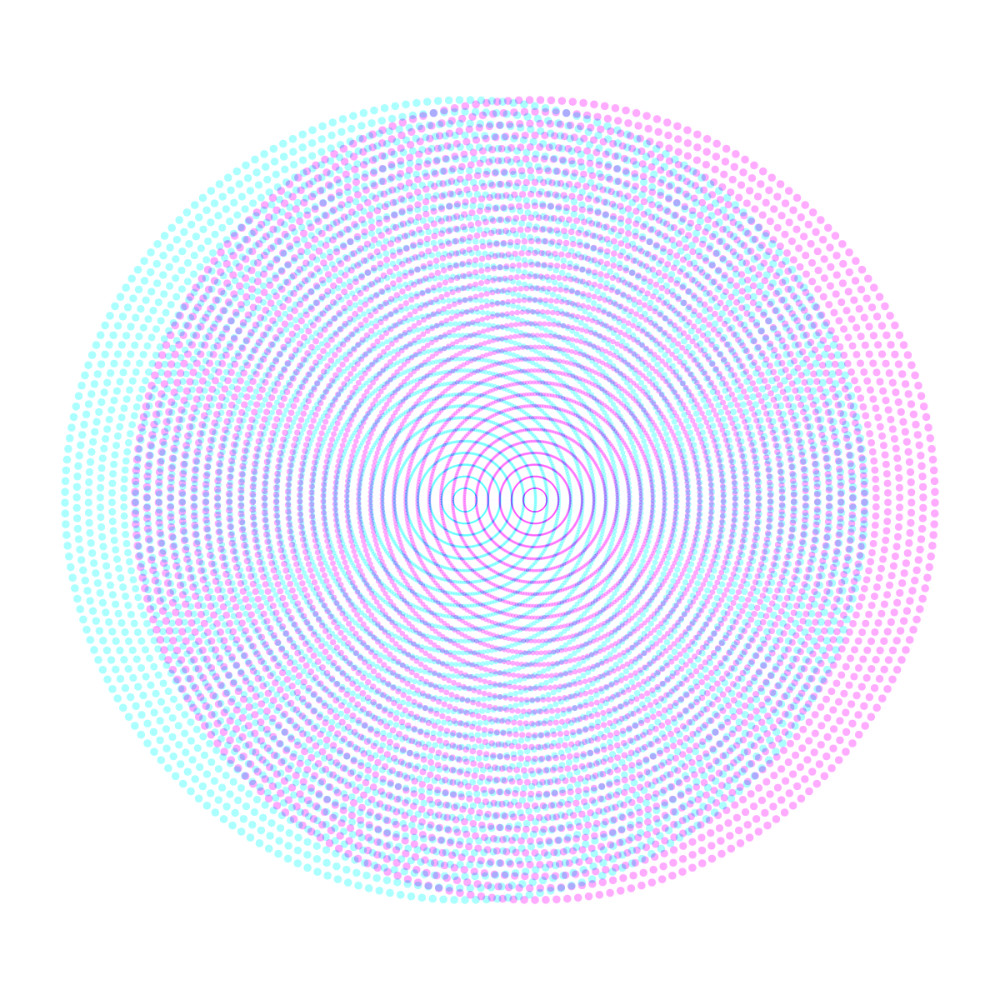

alpha_=4.38e-01


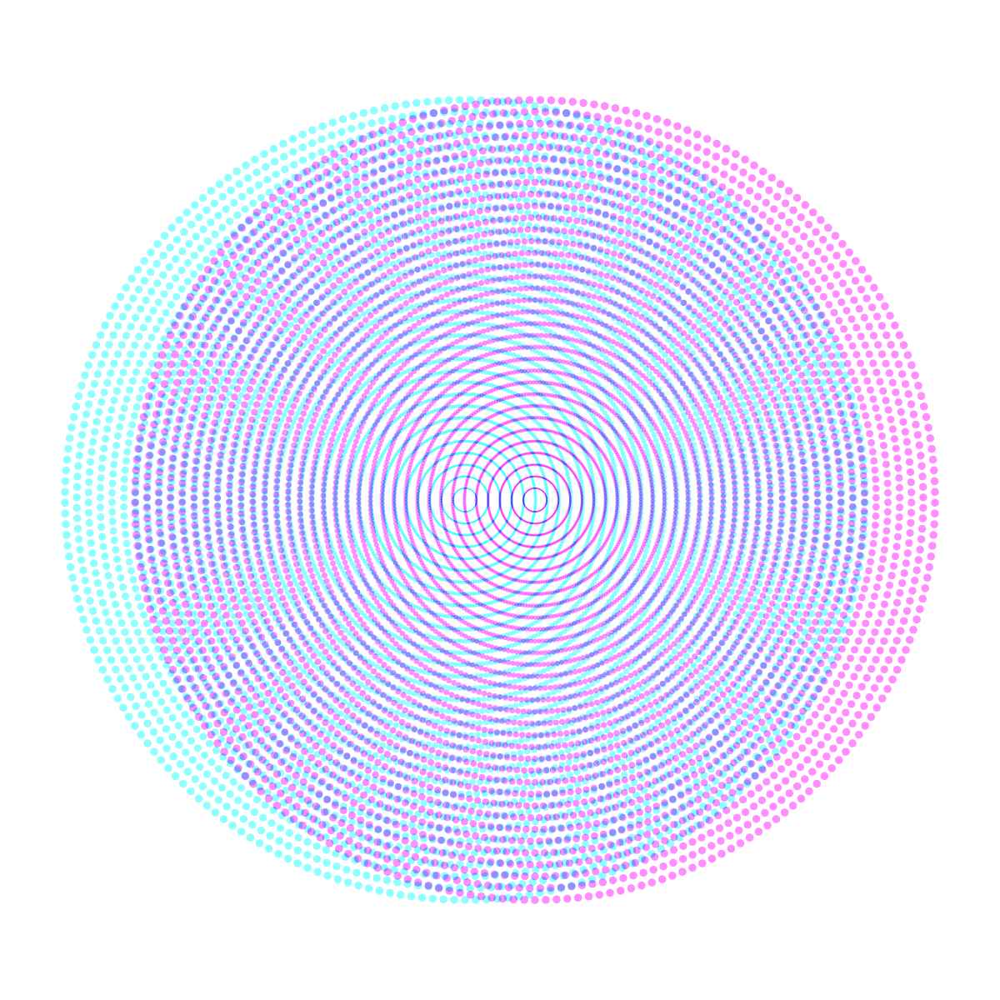

alpha_=5.50e-01


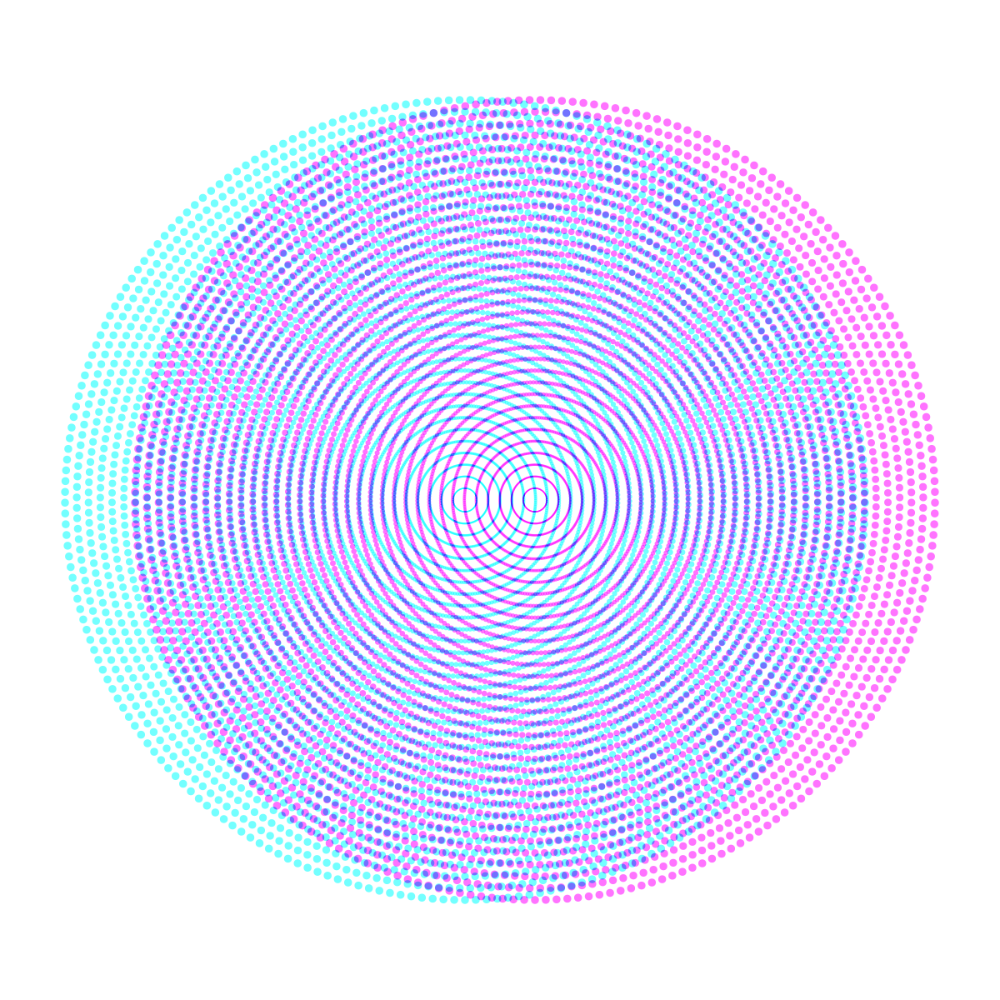

alpha_=6.62e-01


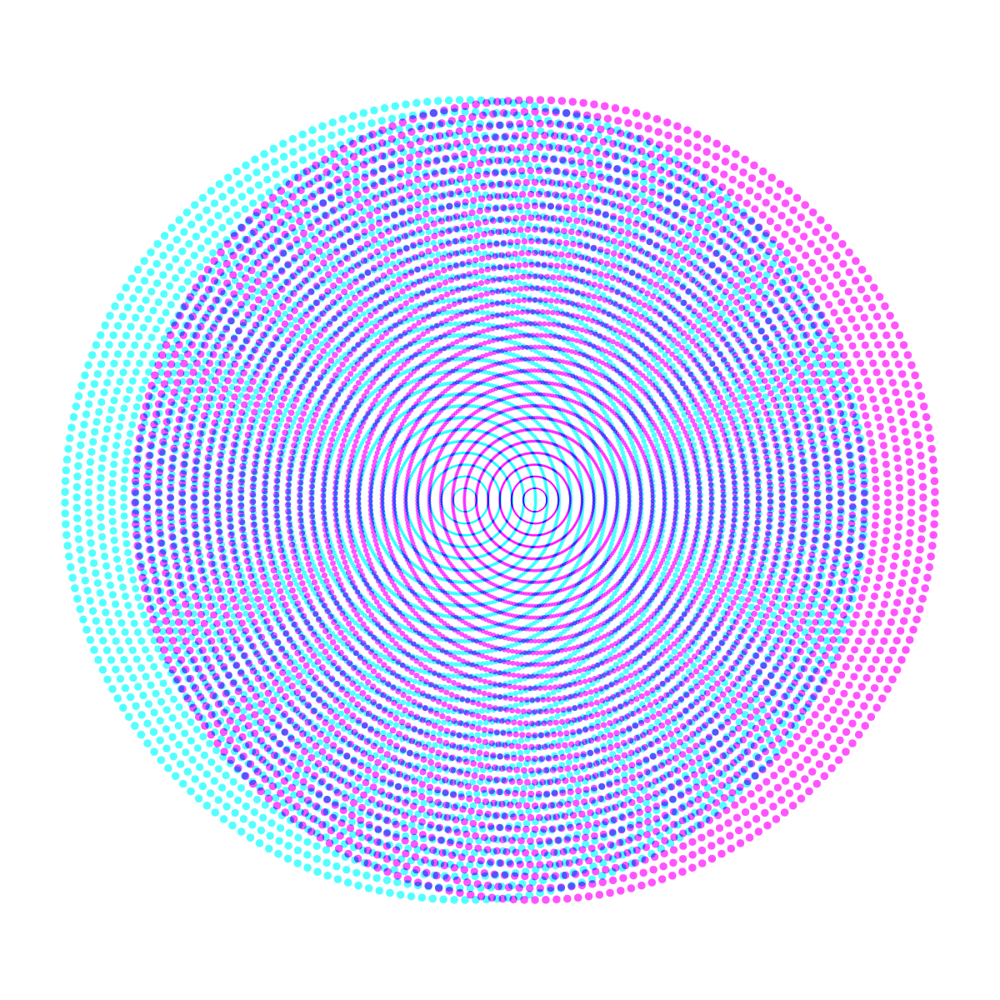

alpha_=7.75e-01


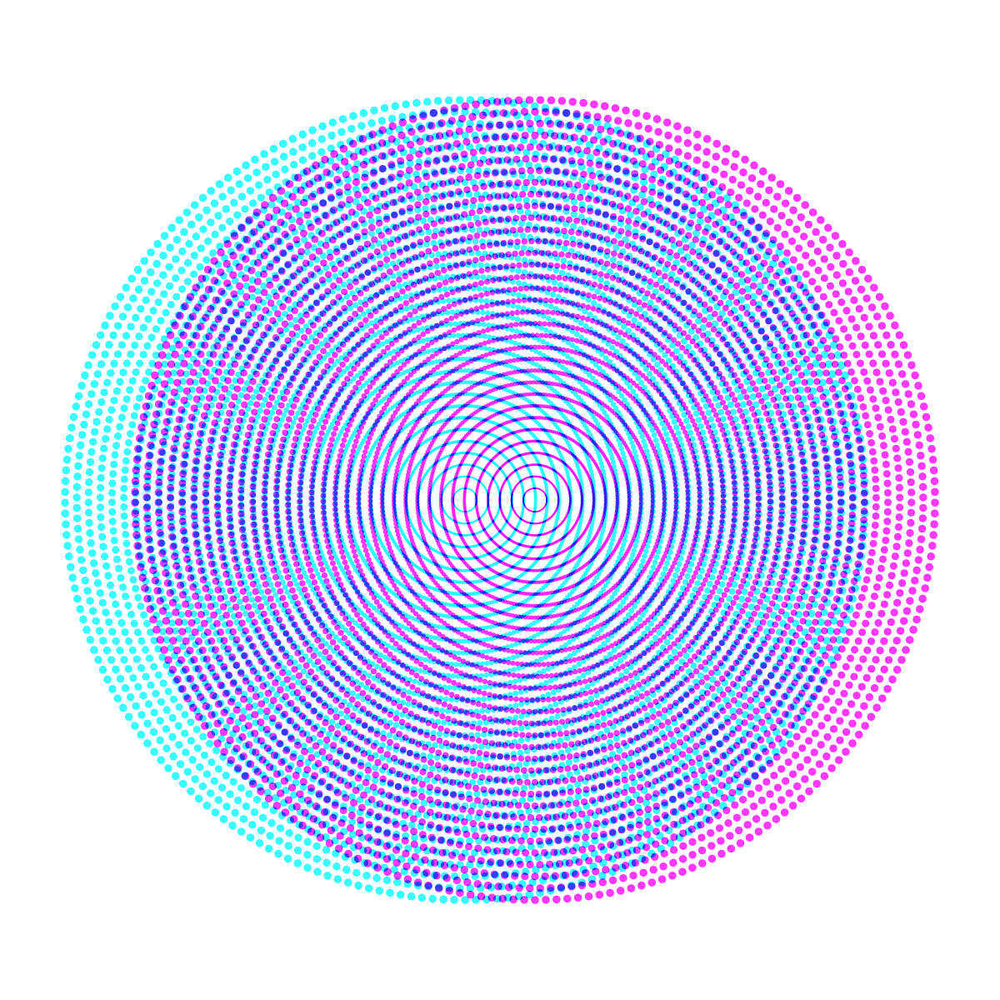

alpha_=8.87e-01


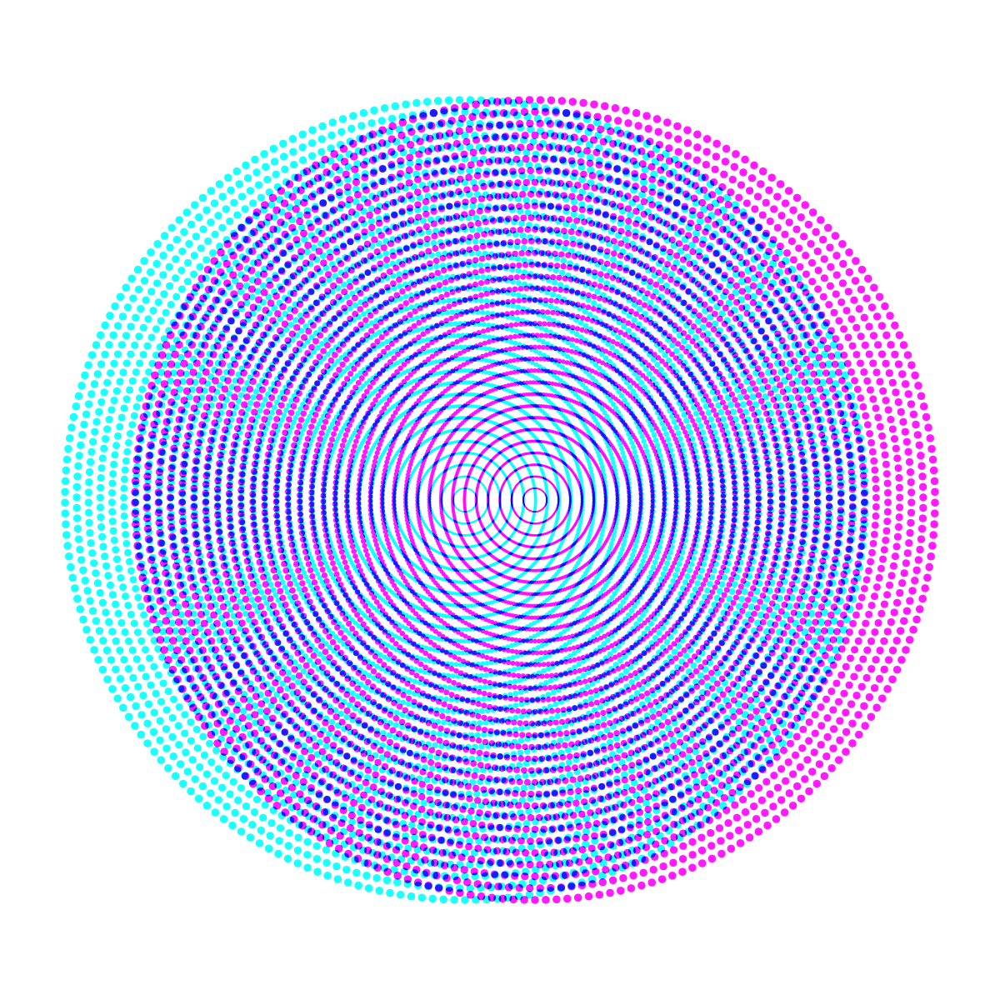

alpha_=1.00e+00


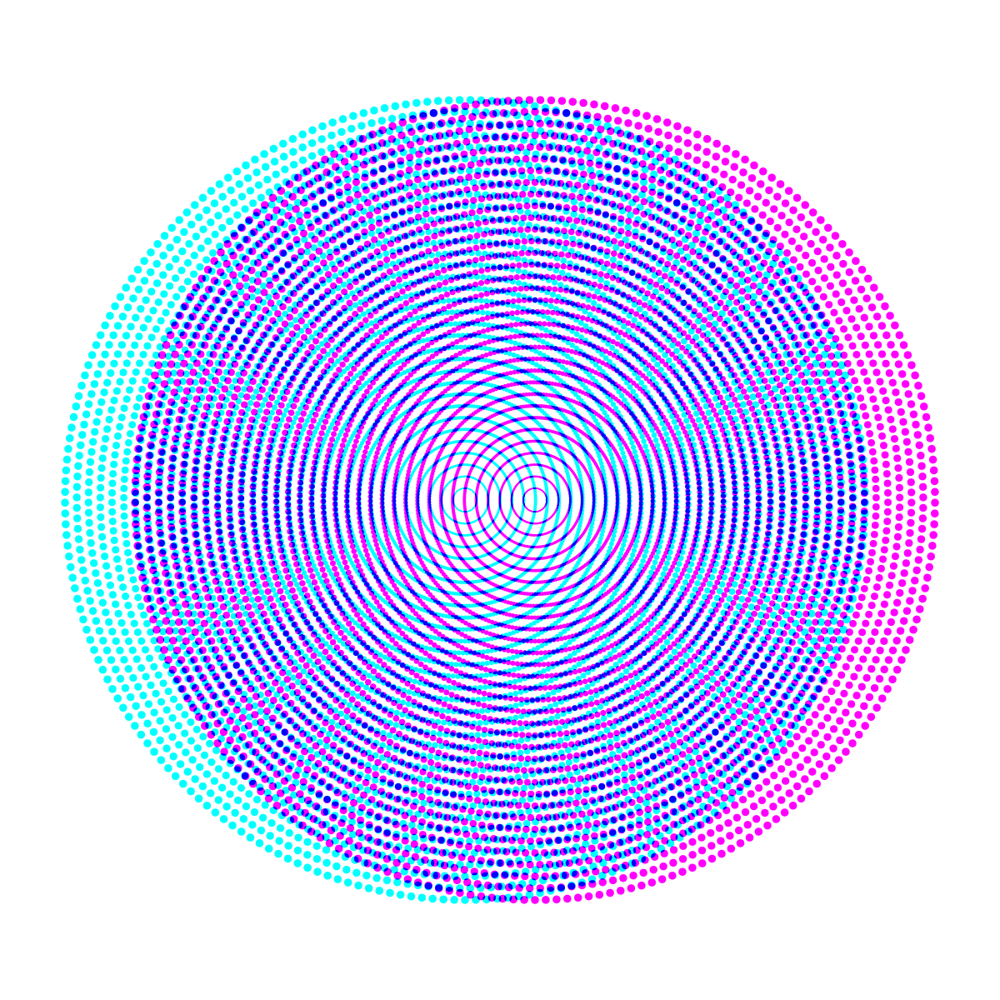

In [10]:
opts_ = opts.copy()
for alpha_ in np.linspace(0.1, 1., N_scan, endpoint=True): 
    opts_.update(alpha=alpha_)
    print(f'{alpha_=:.2e}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)


## offset

offset_=1.00e-03


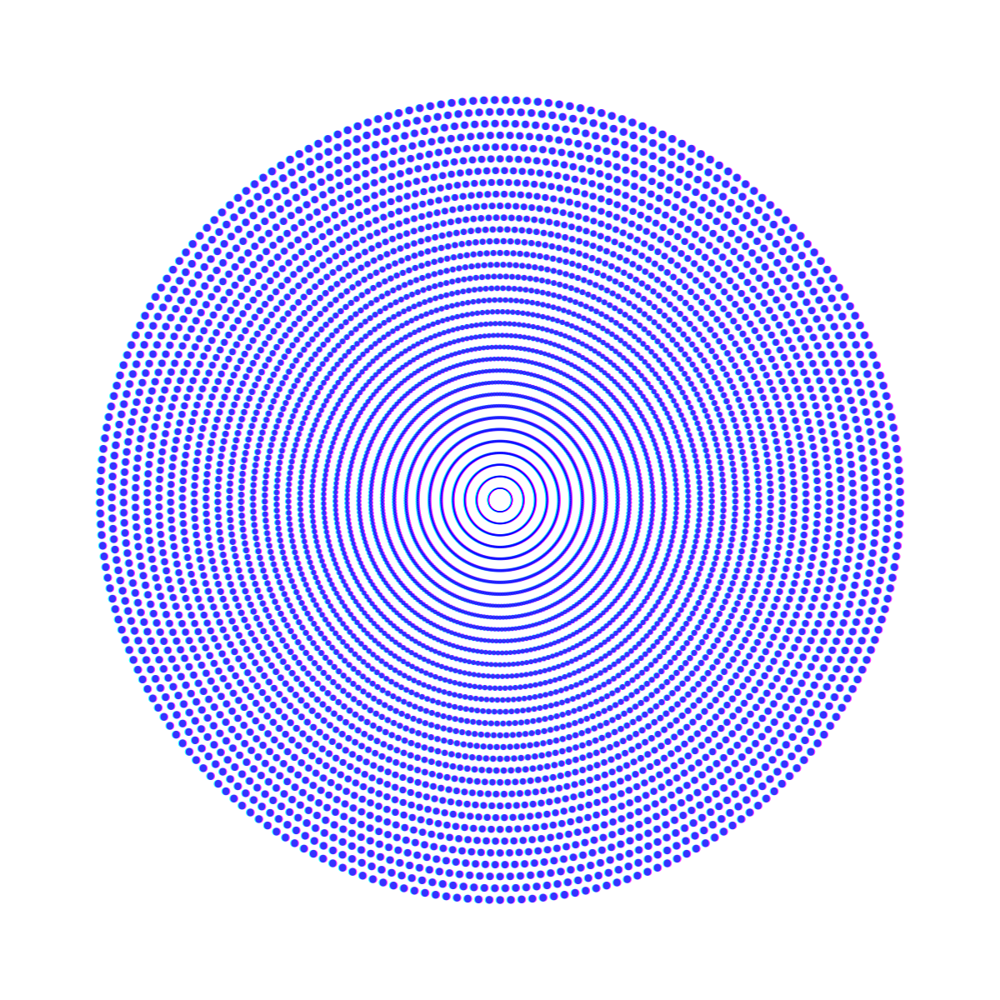

offset_=2.04e-03


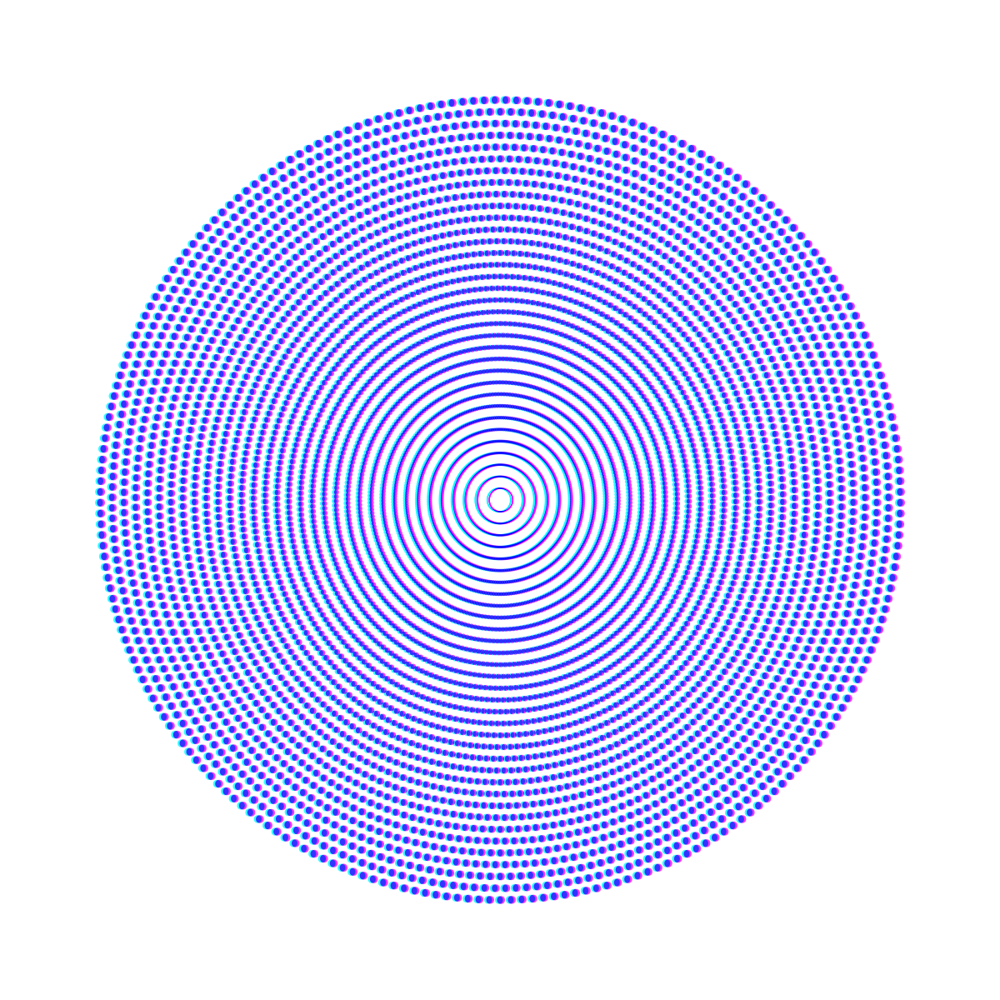

offset_=4.16e-03


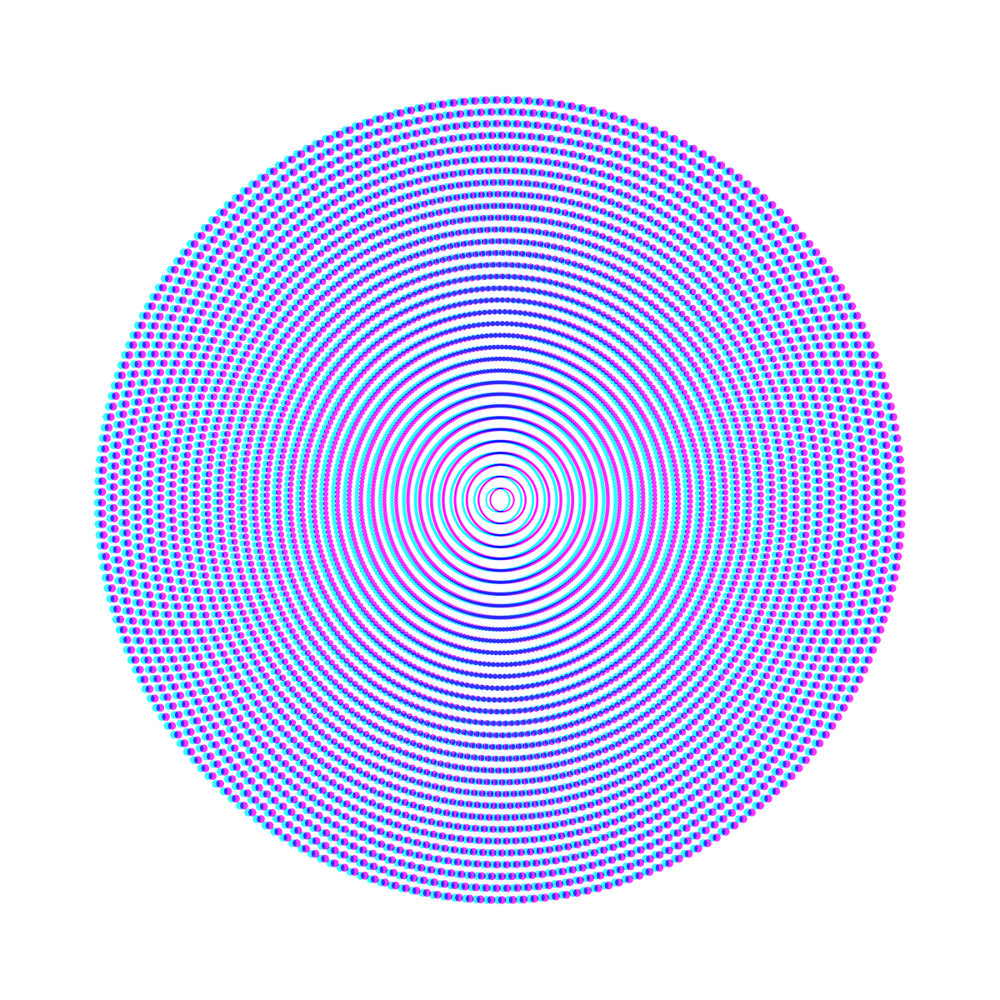

offset_=8.49e-03


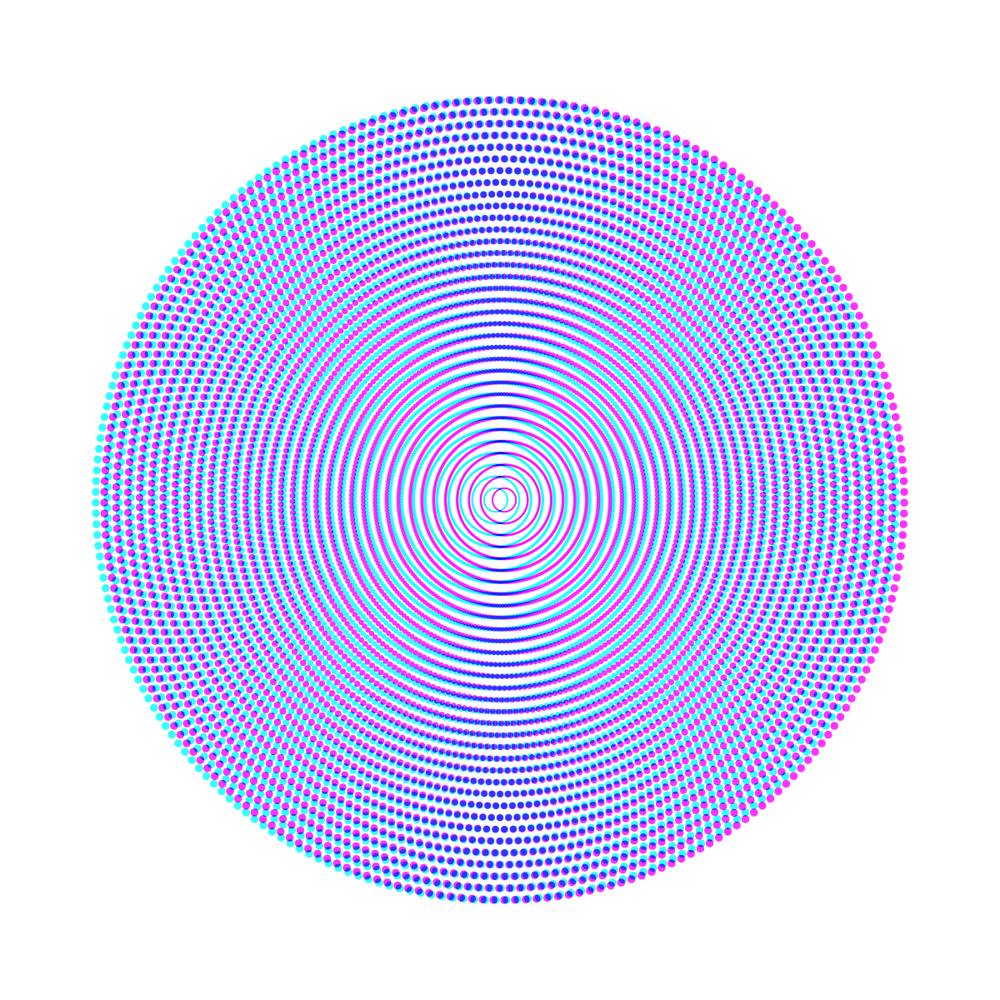

offset_=1.73e-02


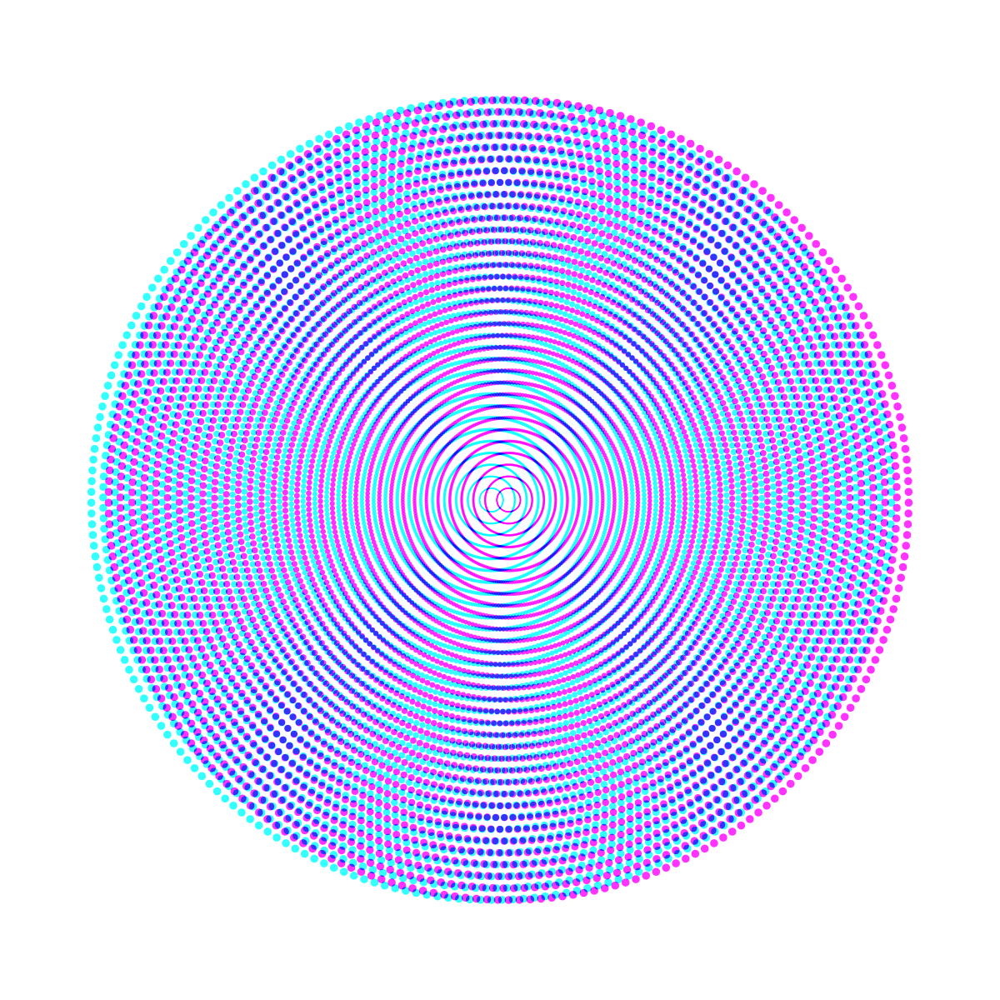

offset_=3.53e-02


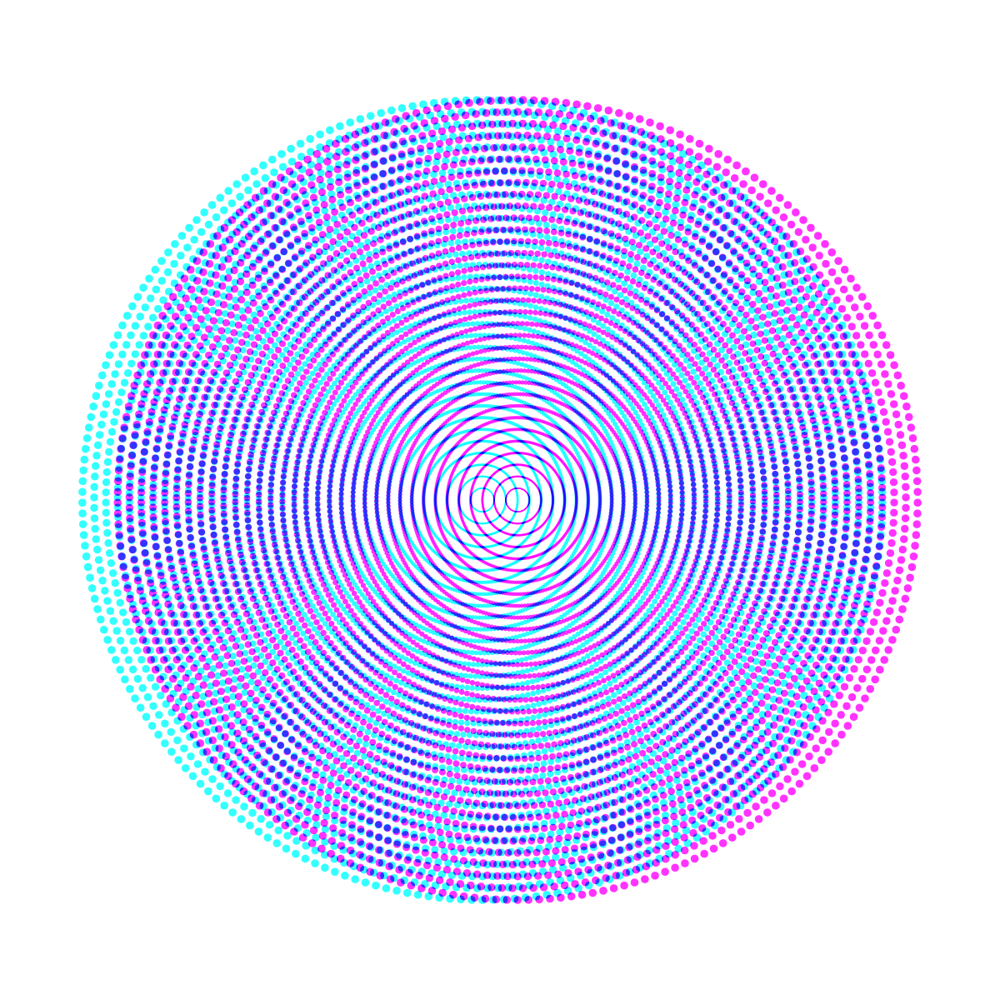

offset_=7.21e-02


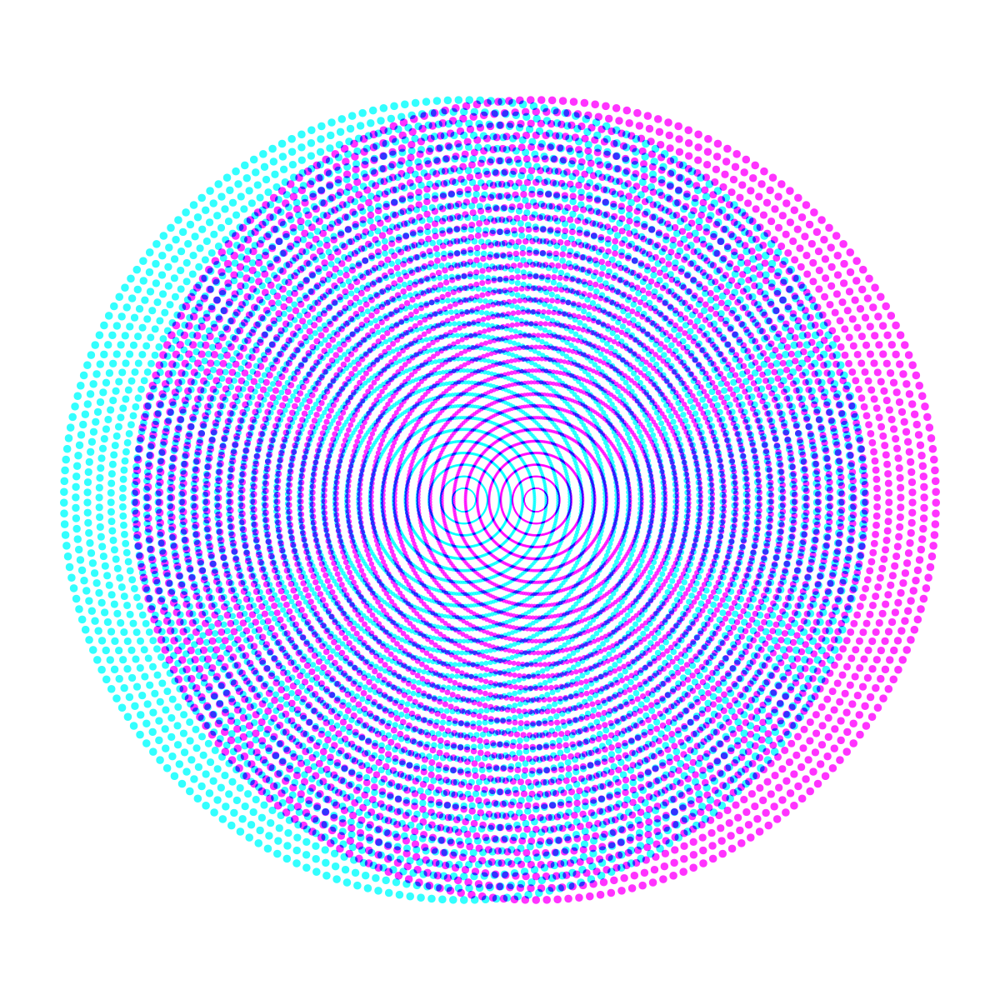

offset_=1.47e-01


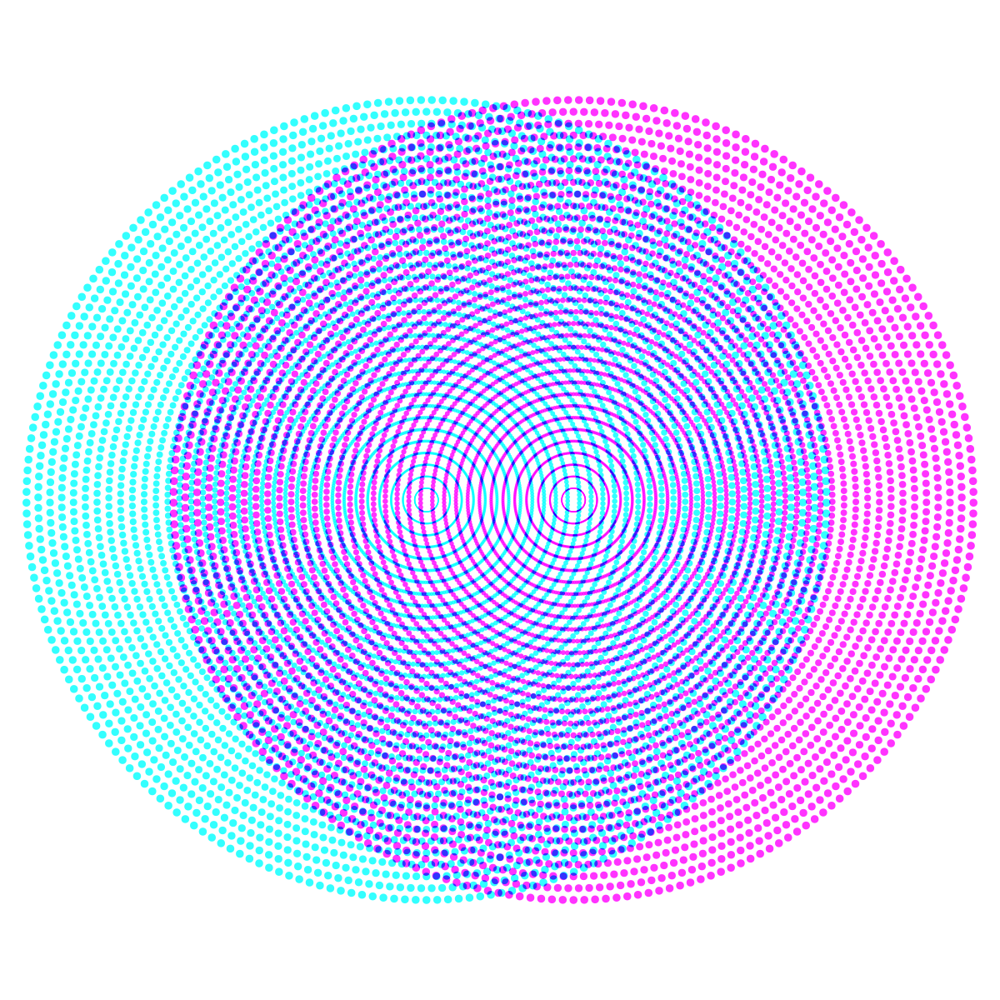

offset_=3.00e-01


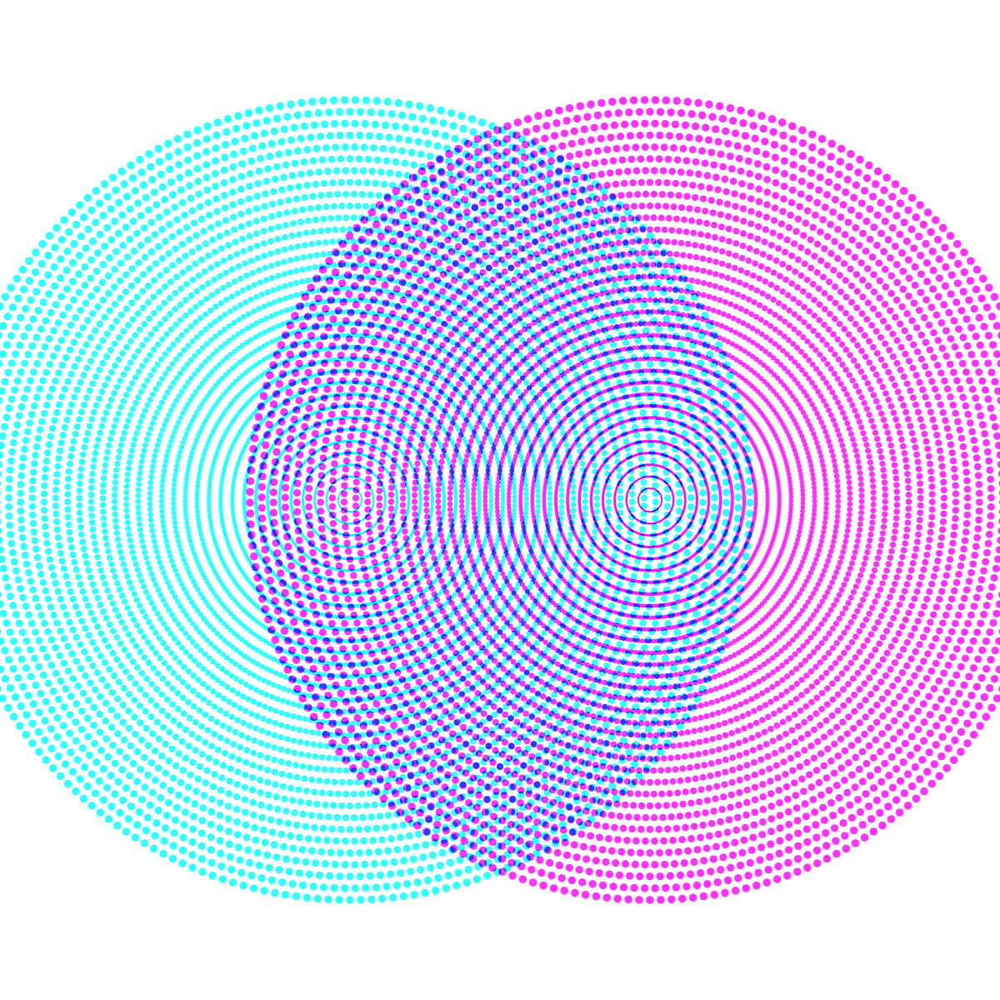

In [11]:
opts_ = opts.copy()
for offset_ in np.geomspace(0.001, .3, N_scan, endpoint=True): 
    opts_.update(offset=offset_)
    print(f'{offset_=:.2e}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)


In [ ]:
opts_ = opts.copy()
fnames = []
for i_offset, offset_ in enumerate(0.25 * np.sin(2* np.pi * np.linspace(0., 1., 200, endpoint=False))): 
    opts_.update(offset=offset_)
    # print(f'{offset_=:.2e}')
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)
    fname = f'/tmp/frame{i_offset:04d}.png'
    render_png(draw, fname)
    fnames.append(fname)


In [ ]:
# %conda install moviepy

In [ ]:

from moviepy.editor import ImageSequenceClip
clip = ImageSequenceClip(fnames, fps=20)
clip.write_videofile("2025-01-18_la-vibration-des-apparences.mp4", codec="libx264")

## c1

In [ ]:
opts_ = opts.copy()
for c1_ in np.linspace(0., 360., N_scan, endpoint=False): 
    opts_.update(c1=c1_)
    print(f'{c1_=:.2f}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)


## c2

In [ ]:
opts_ = opts.copy()
for c2_ in np.linspace(0., 360., N_scan, endpoint=False): 
    opts_.update(c2=c2_)
    print(f'{c2_=:.2f}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)


## color around blue

In [ ]:
opts_ = opts.copy()
for dc in np.linspace(0., 180, N_scan, endpoint=False): 
    opts_.update(c1=c_blue-dc, c2=c_blue+dc)
    print(f'{dc=:.2e}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)


## N_rho

In [ ]:
opts_ = opts.copy()
N_rhos = [int(k) for k in N_rho * np.logspace(-1, 1, N_scan, base=1.5, endpoint=True)]
for N_rho_ in N_rhos: 
    opts_.update(N_rho=N_rho_)
    print(f'{N_rho_=}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)

## N_phi

In [ ]:
opts_ = opts.copy()
N_phis = [int(k) for k in N_phi * np.logspace(-1, 1, N_scan, base=1.5, endpoint=True)]
for N_phi_ in N_phis: 
    opts_.update(N_phi=N_phi_)
    print(f'{N_phi_=}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)

## power

In [ ]:
opts_ = opts.copy()
for power_ in np.linspace(0.1, 1.6, N_scan, endpoint=True): 
    opts_.update(power=power_)
    print(f'{power_=:.2e}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)


## ecc_max

In [ ]:
opts_ = opts.copy()
for ecc_max_ in np.linspace(0.5, 1.5, N_scan, endpoint=True): 
    opts_.update(ecc_max=ecc_max_)
    print(f'{ecc_max_=:.2e}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)

## `cairo.OPERATOR_*`

In [ ]:
cairo.OPERATOR_MULTIPLY

In [ ]:
op = cairo.OPERATOR_MULTIPLY
op

In [ ]:
str(op)

In [ ]:
opts_ = opts.copy()

# Dictionnaire des noms des opérateurs
operator_names = {
    cairo.OPERATOR_CLEAR: "CLEAR",
    cairo.OPERATOR_OVER: "OVER",
    cairo.OPERATOR_ADD: "ADD",
    cairo.OPERATOR_SOURCE: "SOURCE",
    cairo.OPERATOR_OVER: "OVER",
    cairo.OPERATOR_OUT: "OUT",
    cairo.OPERATOR_SCREEN: "SCREEN",
    cairo.OPERATOR_DEST_OUT: "DEST_OUT"
}

for operator_ in operator_names.keys():
    opts_.update(operator=operator_)
    print(f'{operator_names[operator_]}')
    @disp
    def draw(cr, N_H=N_H, N_V=N_V): cr = retino_grid(cr, **opts_)
